In [2]:
import os

import matplotlib.pyplot as plt

from PIL import Image
from src.config import FENCE_IMG_PATH, BG_IMG_PATH

# Data Exploration


## Training Data Set


In [3]:
fence_images = []
fence_edge_cases = []

background_images = [
    os.path.join(BG_IMG_PATH, f) for f in os.listdir(BG_IMG_PATH) if f.endswith("jpg")
]

for subdir in os.listdir(FENCE_IMG_PATH):
    subdir_path = os.path.join(FENCE_IMG_PATH, subdir)
    if os.path.isdir(subdir_path):
        fence_images.extend(
            [
                os.path.join(subdir_path, f)
                for f in os.listdir(subdir_path)
                if f.endswith("jpg")
            ]
        )
        edge_cases_path = os.path.join(subdir_path, "edge_cases")
        if os.path.isdir(edge_cases_path):
            fence_edge_cases.extend(
                [
                    os.path.join(edge_cases_path, f)
                    for f in os.listdir(edge_cases_path)
                    if f.endswith("jpg")
                ]
            )
print(f"Found {len(fence_images)} fence images")
print(f"Found {len(fence_edge_cases)} fence edge cases")
print(f"Found {len(background_images)} background images")

Found 286 fence images
Found 21 fence edge cases
Found 84 background images


## Image Resolutions for Training


Background image size: (6000, 4000)


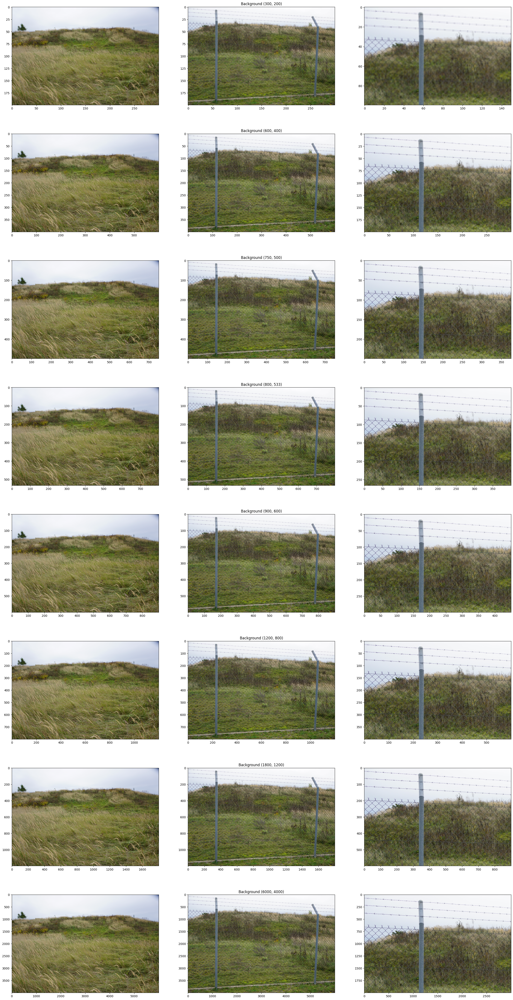

In [4]:
bg_image_path = "imgs/backgrounds/DSC01860.jpg"
fence_image_path = "imgs/fences/grass/DSC01916.jpg"

bg_img = Image.open(bg_image_path).convert("RGB")
fence_img = Image.open(fence_image_path).convert("RGB")

print(f"Background image size: {bg_img.size}")

resolutions = [
    (300, 200),
    (600, 400),
    (750, 500),
    (800, 533),
    (900, 600),
    (1200, 800),
    (1800, 1200),
    (6000, 4000),
]

fig, axs = plt.subplots(len(resolutions), 3, figsize=(30, 60))

for i, resolution in enumerate(resolutions):
    resized_fence_img = fence_img.resize(resolution)
    cropped_fence_img = resized_fence_img.crop(
        (0, 0, resolution[0] // 2, resolution[1] // 2)
    )

    axs[i, 1].set_title(f"Background {resolution}")
    axs[i, 0].imshow(bg_img.resize(resolution))
    axs[i, 1].imshow(resized_fence_img)
    axs[i, 2].imshow(cropped_fence_img)


plt.show()

### Resolutions to experiment with:

#### (750, 500)

#### (800, 533)

#### (900, 600)

#### (1200, 800)


## Check crop


In [ ]:
from src.models import Generator

gen = Generator(
    g_type="resnet-6",
    img_size=(512, 768),
    ngf=64,
    norm_type="instance",
    n_downsampling=6,
)

/Users/jjaenckel/miniforge3/envs/master_thesis/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/Users/jjaenckel/miniforge3/envs/master_thesis/lib/python3.11/site-packages/diffusers/utils/outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(


In [ ]:
import matplotlib.pyplot as plt

from src.data_pipeline import UnpairedImageDataModule

# Initialize the data module
data_module = UnpairedImageDataModule(img_h=512, img_w=768, batch_size=4, crop=True)

# Set up the data module
data_module.setup(stage="fit")

# Get the train dataloaders
train_dataloaders = data_module.train_dataloader()

bg_imgs = []
fence_imgs = []

# Iterate over one batch from each dataloader
for domain, dataloader in train_dataloaders.items():

    print(f"Processing {domain} images:")

    for batch in dataloader:
        if domain == "fence":
            fence_imgs.append(batch)
            break

        break
        img = batch
        fake = gen(img)
        bg_imgs.append(fake)
        break

Processing background images:


python(48069) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(48070) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(48071) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(48072) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


Processing fence images:


python(48084) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(48085) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(48086) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(48087) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


In [15]:
# save all fence imgs to disk
for i, batch in enumerate(fence_imgs):
    batch = batch / 2 + 0.5
    # show save all img from batch [b, c, h, w]
    for j in range(batch.shape[0]):
        img = batch[j].permute(1, 2, 0).cpu().numpy()
        plt.imsave(f"imgs/fence0{j+1}_cropped.jpg", img)
    

In [13]:
fence_imgs[0].shape

torch.Size([4, 3, 512, 768])

In [ ]:
print(bg_imgs[0].shape);
print(fence_imgs[0].shape);


torch.Size([4, 3, 512, 768])
torch.Size([4, 3, 512, 768])


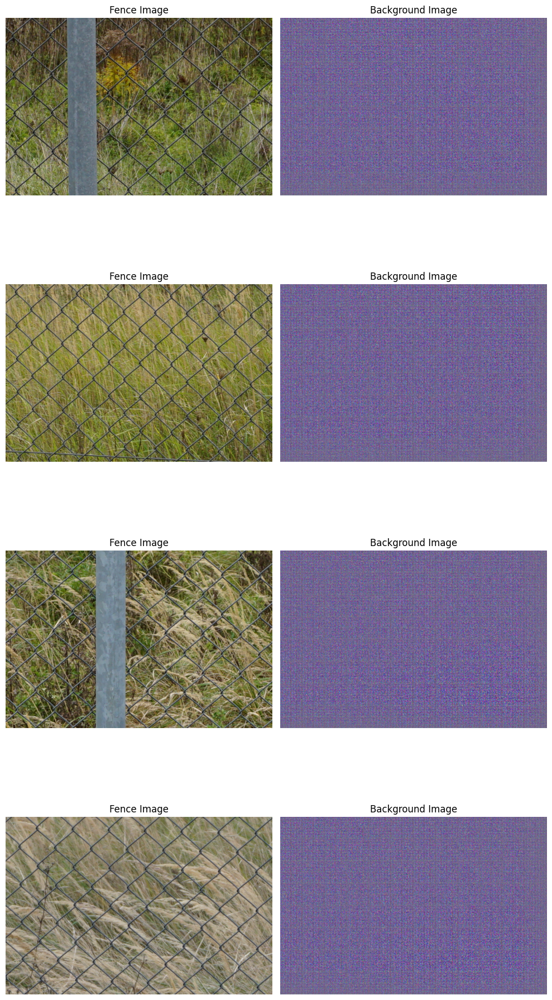

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Define the number of images to display
num_to_display = 4  # We want to display 4 pairs of images

# Create a figure with specified size and layout
fig, axs = plt.subplots(num_to_display, 2, figsize=(10, 5 * num_to_display))

# Loop through each image in the batch
for i in range(num_to_display):
    # Access the i-th image within each batch
    fence_img = fence_imgs[0][i]  # Accesses the i-th image in the first batch
    bg_img = bg_imgs[0][i]  # Accesses the i-th image in the first batch

    # Normalize images from [-1, 1] to [0, 1] if necessary
    fence_img = fence_img / 2 + 0.5
    bg_img = bg_img / 2 + 0.5

    # Convert tensors to numpy arrays for displaying
    fence_img_np = fence_img.detach().cpu().numpy()
    bg_img_np = bg_img.detach().cpu().numpy()

    # Transpose if necessary (from [3, 512, 768] to [512, 768, 3])
    if fence_img_np.shape[0] == 3:
        fence_img_np = fence_img_np.transpose(1, 2, 0)
    if bg_img_np.shape[0] == 3:
        bg_img_np = bg_img_np.transpose(1, 2, 0)

    # Display images
    axs[i, 0].imshow(np.clip(fence_img_np, 0, 1))
    axs[i, 1].imshow(np.clip(bg_img_np, 0, 1))

    # Set titles and turn off axes for a cleaner look
    axs[i, 0].set_title("Fence Image")
    axs[i, 1].set_title("Background Image")
    axs[i, 0].axis("off")
    axs[i, 1].axis("off")

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()